## Companies Bankruptcy Prediction Project - Classification Model

## Source of Data
Kaggle.com
https://www.kaggle.com/datasets/utkarshx27/american-companies-bankruptcy-prediction-dataset

## Importance of the project

•The dataset includes financial information of many American companies extracted from their financial statements such as the sales, the cost of goods sold, the net income, the assets and liabilities from 1999 to 2018.

•Many ratios can be calculated from provided data that can give more insights about companies’ profitability, liquidity and solvency that may increase the accuracy of the prediction model

•The prediction model will provide a tool that can allow companies and stakeholders-such as banks and investors-to predict the bankruptcy of a company based on financial information extracted from the financial statements. The model can be useful not only for American companies but to it can be applied for other companies worldwide. 

## Importing Libraries

In [3]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

## Reading the dataset

In [4]:
df = pd.read_csv('american_bankruptcy.csv')
df.head()

,company_name,status_label,year,X1,X2,X3,X4,X5,X6,X7,...,X9,X10,X11,X12,X13,X14,X15,X16,X17,X18
0,C_1,alive,1999,511.267,833.107,18.373,89.031,336.018,35.163,128.348,...,1024.333,740.998,180.447,70.658,191.226,163.816,201.026,1024.333,401.483,935.302
1,C_1,alive,2000,485.856,713.811,18.577,64.367,320.590,18.531,115.187,...,874.255,701.854,179.987,45.790,160.444,125.392,204.065,874.255,361.642,809.888
2,C_1,alive,2001,436.656,526.477,22.496,27.207,286.588,-58.939,77.528,...,638.721,710.199,217.699,4.711,112.244,150.464,139.603,638.721,399.964,611.514
3,C_1,alive,2002,396.412,496.747,27.172,30.745,259.954,-12.410,66.322,...,606.337,686.621,164.658,3.573,109.590,203.575,124.106,606.337,391.633,575.592
4,C_1,alive,2003,432.204,523.302,26.680,47.491,247.245,3.504,104.661,...,651.958,709.292,248.666,20.811,128.656,131.261,131.884,651.958,407.608,604.467


## Exploring & Analysing Data

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78682 entries, 0 to 78681
Data columns (total 21 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   company_name  78682 non-null  object 
 1   status_label  78682 non-null  object 
 2   year          78682 non-null  int64  
 3   X1            78682 non-null  float64
 4   X2            78682 non-null  float64
 5   X3            78682 non-null  float64
 6   X4            78682 non-null  float64
 7   X5            78682 non-null  float64
 8   X6            78682 non-null  float64
 9   X7            78682 non-null  float64
 10  X8            78682 non-null  float64
 11  X9            78682 non-null  float64
 12  X10           78682 non-null  float64
 13  X11           78682 non-null  float64
 14  X12           78682 non-null  float64
 15  X13           78682 non-null  float64
 16  X14           78682 non-null  float64
 17  X15           78682 non-null  float64
 18  X16           78682 non-nu

In [6]:
# checking null values
df.isnull().sum()

company_name    0
status_label    0
year            0
X1              0
X2              0
X3              0
X4              0
X5              0
X6              0
X7              0
X8              0
X9              0
X10             0
X11             0
X12             0
X13             0
X14             0
X15             0
X16             0
X17             0
X18             0
dtype: int64

In [7]:
# checking duplicated entries

df.duplicated().sum()

0

### Preprocessing

In [8]:
# renaming columns based on the description set on Kaggle.com to have a more comprehensive data and faciliate the analysis phase

df.rename(columns={'X1':'Current_assets', 'X2':'COGS','X3':'Depreciation','X4':'EBITDA','X5':'Inventory','X6':'Net_Income','X7':'Receivables','X8':'Market_value','X9':'Net_sales','X10':'Total_assets', 'X11':'Longterm_debt','X12':'EBIT','X13':'Gross_Profit','X14':'Current_Liabilities','X15':'Retained_Earnings','X16':'Total_Revenue ','X17':'Total_Liabilities','X18':'Operating_Expenses'}, inplace=True)

In [9]:
# checking the change in columns names
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78682 entries, 0 to 78681
Data columns (total 21 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   company_name         78682 non-null  object 
 1   status_label         78682 non-null  object 
 2   year                 78682 non-null  int64  
 3   Current_assets       78682 non-null  float64
 4   COGS                 78682 non-null  float64
 5   Depreciation         78682 non-null  float64
 6   EBITDA               78682 non-null  float64
 7   Inventory            78682 non-null  float64
 8   Net_Income           78682 non-null  float64
 9   Receivables          78682 non-null  float64
 10  Market_value         78682 non-null  float64
 11  Net_sales            78682 non-null  float64
 12  Total_assets         78682 non-null  float64
 13  Longterm_debt        78682 non-null  float64
 14  EBIT                 78682 non-null  float64
 15  Gross_Profit         78682 non-null 

In [10]:
# dropping unnecessary columns
df.drop(columns='company_name', inplace=True)

In [11]:
# drawing histogram of the target column
px.histogram(df, x='status_label', histnorm = 'percent')

- The histogram showed imbalanced data. 
- Only 7% of the data is classified as failed 
- Oversampling will be applied in the modeling phase to handle this point 

### Checking & Handling Outliers

#### Plotting boxplot for all features to check outliers

year                       AxesSubplot(0.125,0.71587;0.133621x0.16413)
Current_assets          AxesSubplot(0.285345,0.71587;0.133621x0.16413)
COGS                     AxesSubplot(0.44569,0.71587;0.133621x0.16413)
Depreciation            AxesSubplot(0.606034,0.71587;0.133621x0.16413)
EBITDA                  AxesSubplot(0.766379,0.71587;0.133621x0.16413)
Inventory                 AxesSubplot(0.125,0.518913;0.133621x0.16413)
Net_Income             AxesSubplot(0.285345,0.518913;0.133621x0.16413)
Receivables             AxesSubplot(0.44569,0.518913;0.133621x0.16413)
Market_value           AxesSubplot(0.606034,0.518913;0.133621x0.16413)
Net_sales              AxesSubplot(0.766379,0.518913;0.133621x0.16413)
Total_assets              AxesSubplot(0.125,0.321957;0.133621x0.16413)
Longterm_debt          AxesSubplot(0.285345,0.321957;0.133621x0.16413)
EBIT                    AxesSubplot(0.44569,0.321957;0.133621x0.16413)
Gross_Profit           AxesSubplot(0.606034,0.321957;0.133621x0.16413)
Curren

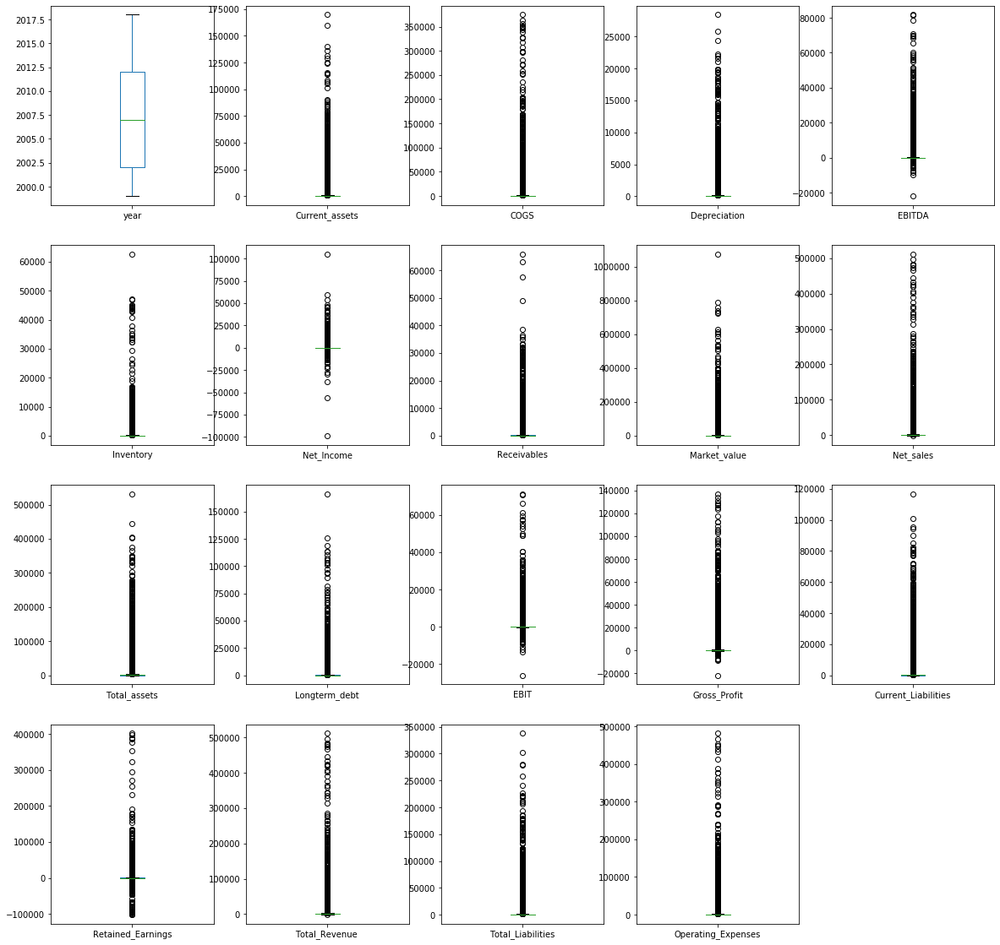

In [12]:
df.plot(kind = 'box', subplots = True, figsize = (20,20), layout = (4,5))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x00000237F4CB1A88>,
      dtype=object)

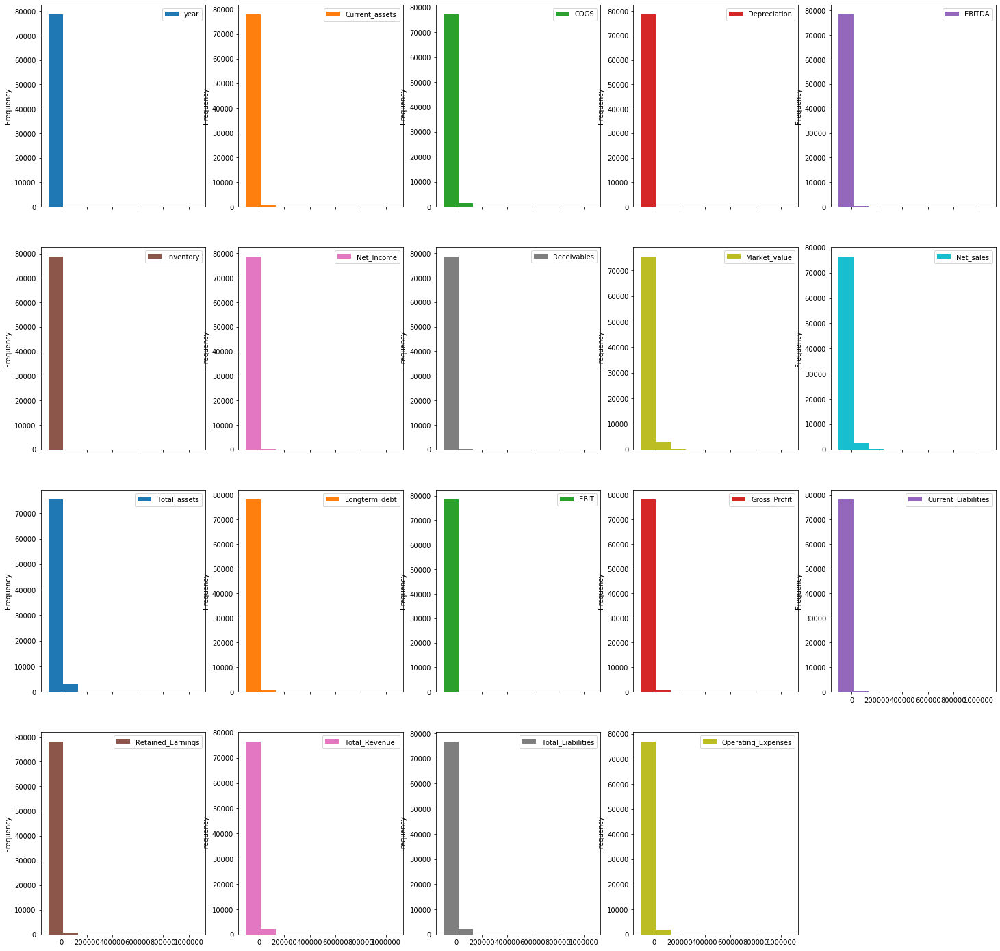

In [13]:
df.plot(kind = 'hist', subplots = True, figsize = (25,25), layout = (4,5))

#### Almost all features have outliers values 

In [14]:
df.describe()

,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
count,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,7.868200e+04,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000
mean,2007.506317,880.362485,1594.529029,121.234256,376.759424,201.605717,129.382453,286.832743,3.414355e+03,2364.019706,2867.110620,722.483710,255.525035,769.490783,610.072255,532.467069,2364.019706,1773.563963,1987.260307
std,5.742768,3928.564794,8930.484664,652.376804,2012.023142,1060.766096,1265.532022,1335.978571,1.841410e+04,11950.068842,12917.944421,3242.170946,1494.643534,3774.703114,2938.387443,6369.159440,11950.068842,8053.684902,10419.629038
min,1999.000000,-7.760000,-366.645000,0.000000,-21913.000000,0.000000,-98696.000000,-0.006000,1.000000e-04,-1964.999000,0.001000,-0.023000,-25913.000000,-21536.000000,0.001000,-102362.000000,-1964.999000,0.001000,-317.197000
25%,2002.000000,18.924000,17.038250,1.192000,-0.811000,0.000000,-7.415750,3.281250,3.498000e+01,27.548500,37.363500,0.000000,-2.787000,8.521250,8.889250,-68.282750,27.548500,13.486000,32.872500
50%,2007.000000,100.449500,103.661000,7.929500,15.034500,7.023000,1.616000,22.820000,2.275118e+02,186.598500,213.203500,7.593500,6.518000,63.581500,43.333000,-1.131000,186.598500,81.988000,168.912000
75%,2012.000000,431.526750,634.548000,47.971750,139.655250,74.747250,40.144250,131.580500,1.244890e+03,1046.402500,1171.364750,248.760750,87.599000,344.074250,222.817000,146.070000,1046.402500,629.975000,875.522250
max,2018.000000,169662.000000,374623.000000,28430.000000,81730.000000,62567.000000,104821.000000,65812.000000,1.073391e+06,511729.000000,531864.000000,166250.000000,71230.000000,137106.000000,116866.000000,402089.000000,511729.000000,337980.000000,481580.000000


- We can also notice the presence of outliers 
- Some features have negative values
- Net_sales feature & Total_revenue feature having same values

#### To Handle negative values, the following will be applied 
#### Calculating the absolute values for the following features:
- Current assets: as normally assets are shown as positive figures in the financial statements
- COGS & operating expenses: despite being expenses, however, normally figures are shown as positive figures to be then netted from sales to show whether the company generated income or losses 
- Receivables: as normally assets are shown as positive figures in the financial statements
- Longterm_debt: as normally debts are shown as positive figures in the liabilities side of the balance sheet.

####  Keeping the negative values as those figures can be positive or negative based on the profitability of the company:
- EBITDA
- EBIT  
- Gross_Profit
- Retained_Earnings
- Net_Income
- Net_sales: The net sales can be negative due to discounts and returns

In [15]:
df.loc[df['Current_assets'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
23913,alive,2002,-0.013,0.083,0.024,-0.027,0.000,-0.051,0.000,0.2493,0.248,0.083,0.000,-0.051,0.165,0.428,-9.471,0.248,0.428,0.275
47531,alive,2008,-0.011,0.273,0.073,-1.938,0.000,-3.108,-0.006,1.4783,0.227,0.389,4.469,-2.011,-0.046,0.635,-61.514,0.227,5.104,2.165
50613,alive,2008,-0.001,2.084,0.475,-3.666,0.000,-4.603,0.000,5.8284,0.629,1.425,2.515,-4.141,-1.455,2.739,-6.218,0.629,5.254,4.295
72022,alive,2015,-1.124,0.168,0.178,-0.720,0.131,-1.583,0.000,17.7216,0.108,17.254,0.000,-0.898,-0.060,0.596,-6.386,0.108,2.123,0.828
72023,alive,2016,-7.760,0.732,0.717,-3.140,0.160,-6.809,0.000,0.0152,0.470,9.726,0.000,-3.857,-0.262,0.610,-16.399,0.470,4.638,3.610
72024,alive,2017,-2.498,0.781,0.729,-3.346,0.194,-7.191,0.000,13.8450,0.501,14.105,0.000,-4.075,-0.280,0.627,-27.006,0.501,19.655,3.847


In [16]:
df['Current_assets'] = df['Current_assets'].abs()

In [17]:
df.loc[df['COGS'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
25605,alive,2007,3.338,-1.477,0.255,-7.226,1.97,-7.551,0.295,54.9926,1.170,6.508,0.000,-7.481,2.647,1.956,-86.552,1.170,2.485,8.396
32219,alive,2000,45.895,-366.645,53.533,417.924,6.87,53.256,16.566,1027.4597,100.727,929.061,195.303,364.391,467.372,179.074,-483.518,100.727,456.863,-317.197
43514,failed,2010,0.041,-0.018,0.000,0.057,0.00,0.057,0.003,1.2554,0.065,0.045,0.000,0.057,0.083,0.005,-15.777,0.065,0.005,0.008
71991,alive,2018,31.037,-0.092,0.006,-13.091,0.00,-12.727,0.000,85.9815,2.449,47.397,0.000,-13.097,2.541,4.553,-68.521,2.449,16.285,15.540
76621,failed,2013,2.132,-0.666,4.528,-11.422,0.00,-15.948,1.112,232.4207,7.873,187.343,0.000,-15.950,8.539,20.181,-297.877,7.873,20.248,19.295
77229,alive,2014,12.293,-31.437,9.205,63.996,0.00,64.931,3.584,39.6987,32.559,290.505,127.491,54.791,63.996,13.630,-22.962,32.559,262.825,-31.437


In [18]:
df['COGS'] = df['COGS'].abs()

In [19]:
df.loc[df['EBITDA'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
21,alive,2001,1305.200,1484.200,197.800,-55.600,253.600,-1287.700,280.700,3603.6000,2402.800,2499.700,3.000,-253.400,918.600,599.400,495.600,2402.800,606.300,2458.400
22,alive,2002,686.300,677.600,104.700,-192.400,94.900,-1145.000,140.900,1263.3680,1047.700,1144.200,10.800,-297.100,370.100,397.800,-688.000,1047.700,412.000,1240.100
31,alive,1999,9.757,19.796,0.667,-0.265,5.494,-2.207,3.924,3.2449,29.370,13.986,5.974,-0.932,9.574,2.804,-6.375,29.370,8.778,29.635
38,alive,2007,13.454,17.589,0.500,-0.432,6.395,-4.673,5.031,30.4793,28.720,27.171,5.822,-0.932,11.131,6.259,-10.708,28.720,12.296,29.152
39,alive,2008,12.686,19.334,1.686,-2.721,6.950,-11.049,4.282,5.0201,34.280,21.401,0.023,-4.407,14.946,16.483,-21.447,34.280,17.224,37.001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78661,alive,2013,67.835,2.051,0.441,-34.415,7.271,-35.578,0.660,52.0572,2.255,69.325,0.000,-34.856,0.204,6.447,-151.721,2.255,6.940,36.670
78662,alive,2014,58.314,1.833,0.656,-45.934,5.488,-48.205,0.470,17.0644,2.828,59.500,0.000,-46.590,0.995,9.143,-199.926,2.828,9.322,48.762
78663,alive,2015,21.381,4.972,0.486,-33.631,1.025,-35.161,0.040,0.1996,1.316,21.782,0.003,-34.117,-3.656,3.521,-235.087,1.316,3.524,34.947
78664,alive,2016,9.049,1.077,0.190,-12.783,0.213,-13.116,0.030,0.1309,0.545,9.198,0.000,-12.973,-0.532,2.391,-248.203,0.545,2.408,13.328


In [20]:
df.loc[df['Net_Income'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
2,alive,2001,436.656,526.477,22.496,27.207,286.588,-58.939,77.528,364.5928,638.721,710.199,217.699,4.711,112.244,150.464,139.603,638.721,399.964,611.514
3,alive,2002,396.412,496.747,27.172,30.745,259.954,-12.410,66.322,143.3295,606.337,686.621,164.658,3.573,109.590,203.575,124.106,606.337,391.633,575.592
21,alive,2001,1305.200,1484.200,197.800,-55.600,253.600,-1287.700,280.700,3603.6000,2402.800,2499.700,3.000,-253.400,918.600,599.400,495.600,2402.800,606.300,2458.400
22,alive,2002,686.300,677.600,104.700,-192.400,94.900,-1145.000,140.900,1263.3680,1047.700,1144.200,10.800,-297.100,370.100,397.800,-688.000,1047.700,412.000,1240.100
23,alive,2003,1006.000,422.600,59.200,19.900,69.500,-76.700,141.200,2072.9620,773.200,1296.900,400.000,-39.300,350.600,265.500,-771.200,773.200,669.200,753.300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78669,alive,2017,2340.600,1833.200,354.200,758.100,490.400,-296.200,1156.000,2850.9981,3775.900,10252.400,5440.600,403.900,1942.700,1091.800,-1291.700,3775.900,7392.400,3017.800
78670,alive,2018,2482.200,966.700,156.600,412.700,188.100,-324.400,382.400,2985.1014,1961.000,9401.500,5350.700,256.100,994.300,1142.500,-1952.300,1961.000,7220.400,1548.300
78679,alive,2016,63.971,69.074,65.057,79.051,2.581,-1.442,42.467,578.8868,169.858,1746.235,683.985,13.994,100.784,85.765,156.341,169.858,770.233,90.807
78680,alive,2017,135.207,66.527,65.330,69.171,2.013,-20.401,27.217,412.6241,161.884,1736.110,694.035,3.841,95.357,82.010,135.941,161.884,776.697,92.713


In [21]:
df.loc[df['Receivables'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
47531,alive,2008,0.011,0.273,0.073,-1.938,0.0,-3.108,-0.006,1.4783,0.227,0.389,4.469,-2.011,-0.046,0.635,-61.514,0.227,5.104,2.165


In [22]:
df['Receivables'] = df['Receivables'].abs()

In [23]:
df.loc[df['Net_sales'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
10209,alive,2005,3.465,0.204,0.006,-0.287,0.000,-0.277,0.059,1.9398,-0.083,4.108,0.000,-0.293,-0.287,0.006,0.974,-0.083,0.006,0.204
10213,alive,2009,0.861,0.193,0.003,-1.286,0.000,-0.828,0.000,1.4742,-1.093,0.865,0.000,-1.289,-1.286,0.216,-1.242,-1.093,0.216,0.193
10214,alive,2010,0.026,0.152,0.001,-0.452,0.000,-0.213,0.000,0.1053,-0.300,0.026,0.000,-0.453,-0.452,0.003,-1.455,-0.300,0.003,0.152
10215,alive,2011,0.031,0.028,0.000,-0.033,0.000,-1.427,0.008,0.3686,-0.005,0.031,0.000,-0.033,-0.033,1.315,-2.882,-0.005,1.315,0.028
27313,alive,2013,25.751,0.000,0.000,-245.890,0.000,-912.447,24.067,3959.1774,-244.189,3665.519,0.000,-245.890,-244.189,11.298,-1016.841,-244.189,777.725,1.701
27314,alive,2014,65.870,0.000,0.000,-1967.817,0.000,-1219.460,12.870,1333.0013,-1964.999,1368.022,0.000,-1967.817,-1964.999,1.415,-2609.066,-1964.999,69.471,2.818
27315,alive,2015,20.945,0.000,0.000,-1185.049,0.000,-1174.426,7.414,131.1149,-1181.604,37.408,0.000,-1185.049,-1181.604,30.402,-3904.040,-1181.604,30.402,3.445
35644,alive,2011,37.268,17.194,0.627,-19.171,0.551,-19.222,3.748,25.8243,-1.977,66.224,1.283,-19.798,-19.171,21.574,33.508,-1.977,22.857,17.194
51195,alive,2011,11.025,1.299,0.251,-10.166,0.000,-3.834,1.606,5.7788,-0.143,11.680,0.328,-10.417,-1.442,1.156,-357.081,-0.143,2.601,10.023
55498,alive,2003,6.332,6.787,0.689,-6.806,2.309,-7.013,0.066,21.1041,-0.019,8.809,0.152,-7.495,-6.806,2.302,-71.934,-0.019,2.454,6.787


In [24]:
df.loc[df['Longterm_debt'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
19034,alive,2013,0.463,0.006,0.59,-2.786,0.056,5.144,0.006,0.42,0.021,0.659,-0.023,-3.376,0.015,4.39,-33.128,0.021,10.552,2.807


In [25]:
df['Longterm_debt'] = df['Longterm_debt'].abs()

In [26]:
df.loc[df['EBIT'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
15,alive,2014,954.100,1342.700,92.300,83.700,566.700,10.200,231.100,1046.3954,1594.300,1515.000,85.000,-8.600,251.600,412.000,603.900,1594.300,669.900,1510.600
21,alive,2001,1305.200,1484.200,197.800,-55.600,253.600,-1287.700,280.700,3603.6000,2402.800,2499.700,3.000,-253.400,918.600,599.400,495.600,2402.800,606.300,2458.400
22,alive,2002,686.300,677.600,104.700,-192.400,94.900,-1145.000,140.900,1263.3680,1047.700,1144.200,10.800,-297.100,370.100,397.800,-688.000,1047.700,412.000,1240.100
23,alive,2003,1006.000,422.600,59.200,19.900,69.500,-76.700,141.200,2072.9620,773.200,1296.900,400.000,-39.300,350.600,265.500,-771.200,773.200,669.200,753.300
31,alive,1999,9.757,19.796,0.667,-0.265,5.494,-2.207,3.924,3.2449,29.370,13.986,5.974,-0.932,9.574,2.804,-6.375,29.370,8.778,29.635
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78661,alive,2013,67.835,2.051,0.441,-34.415,7.271,-35.578,0.660,52.0572,2.255,69.325,0.000,-34.856,0.204,6.447,-151.721,2.255,6.940,36.670
78662,alive,2014,58.314,1.833,0.656,-45.934,5.488,-48.205,0.470,17.0644,2.828,59.500,0.000,-46.590,0.995,9.143,-199.926,2.828,9.322,48.762
78663,alive,2015,21.381,4.972,0.486,-33.631,1.025,-35.161,0.040,0.1996,1.316,21.782,0.003,-34.117,-3.656,3.521,-235.087,1.316,3.524,34.947
78664,alive,2016,9.049,1.077,0.190,-12.783,0.213,-13.116,0.030,0.1309,0.545,9.198,0.000,-12.973,-0.532,2.391,-248.203,0.545,2.408,13.328


In [27]:
df.loc[df['Gross_Profit'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
52,failed,2001,6540.000,19419.000,1404.000,-456.000,822.000,-1762.000,1414.000,3445.0155,18963.000,32841.000,9834.000,-1860.000,-456.000,7512.000,4042.000,18963.000,27468.000,19419.000
53,failed,2002,4937.000,18555.000,1366.000,-1256.000,627.000,-3511.000,1481.000,1030.1874,17299.000,30267.000,12310.000,-2622.000,-1256.000,7240.000,-399.000,17299.000,29310.000,18555.000
163,alive,2000,0.625,9.397,0.868,-7.988,0.137,-8.920,0.205,1.6323,1.409,1.964,1.418,-8.856,-7.988,4.434,-21.594,1.409,5.852,9.397
164,alive,2001,0.006,2.207,1.382,-0.745,0.000,-3.285,0.000,0.5412,1.462,0.006,0.000,-2.127,-0.745,4.705,-24.880,1.462,4.705,2.207
166,alive,2003,0.002,0.104,0.000,-0.029,0.000,-0.179,0.000,0.0203,0.075,0.002,0.000,-0.029,-0.029,4.944,-25.123,0.075,4.944,0.104
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78647,alive,2014,5.941,0.781,3.871,-15.368,4.070,-18.978,0.702,13.3671,0.628,23.139,2.000,-19.239,-0.153,4.404,-170.540,0.628,6.404,15.996
78648,alive,2015,1.801,2.094,4.829,-12.079,0.777,-17.857,0.641,4.5210,0.932,16.574,2.106,-16.908,-1.162,4.177,-188.397,0.932,6.283,13.011
78663,alive,2015,21.381,4.972,0.486,-33.631,1.025,-35.161,0.040,0.1996,1.316,21.782,0.003,-34.117,-3.656,3.521,-235.087,1.316,3.524,34.947
78664,alive,2016,9.049,1.077,0.190,-12.783,0.213,-13.116,0.030,0.1309,0.545,9.198,0.000,-12.973,-0.532,2.391,-248.203,0.545,2.408,13.328


In [28]:
df.loc[df['Retained_Earnings'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
22,alive,2002,686.3,677.6,104.7,-192.4,94.9,-1145.0,140.9,1263.3680,1047.7,1144.2,10.8,-297.1,370.1,397.8,-688.0,1047.7,412.0,1240.1
23,alive,2003,1006.0,422.6,59.2,19.9,69.5,-76.7,141.2,2072.9620,773.2,1296.9,400.0,-39.3,350.6,265.5,-771.2,773.2,669.2,753.3
24,alive,2004,835.6,440.7,41.7,78.2,97.8,16.4,194.5,1790.3210,784.3,1428.1,400.0,36.5,343.6,302.0,-747.1,784.3,768.8,706.1
25,alive,2005,853.0,681.1,67.2,159.0,140.5,110.7,233.7,2032.9250,1169.2,1535.0,400.0,91.8,488.1,286.6,-648.5,1169.2,761.1,1010.2
26,alive,2006,942.7,801.1,67.8,140.4,165.5,65.7,193.1,1677.1320,1281.9,1611.4,400.0,72.6,480.8,260.1,-567.4,1281.9,737.9,1141.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78668,alive,2016,2071.2,1723.3,342.3,723.6,416.4,-73.7,1054.8,2788.2080,3585.9,10054.1,5122.9,381.3,1862.6,1082.7,-1248.0,3585.9,7164.3,2862.3
78669,alive,2017,2340.6,1833.2,354.2,758.1,490.4,-296.2,1156.0,2850.9981,3775.9,10252.4,5440.6,403.9,1942.7,1091.8,-1291.7,3775.9,7392.4,3017.8
78670,alive,2018,2482.2,966.7,156.6,412.7,188.1,-324.4,382.4,2985.1014,1961.0,9401.5,5350.7,256.1,994.3,1142.5,-1952.3,1961.0,7220.4,1548.3
78671,alive,2013,923.2,1206.0,45.6,409.0,314.6,31.0,266.1,4243.5215,2093.5,1979.9,1272.0,363.4,887.5,490.5,-96.2,2093.5,2035.6,1684.5


In [29]:
df.loc[df['Operating_Expenses'] < 0]

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Revenue,Total_Liabilities,Operating_Expenses
32219,alive,2000,45.895,366.645,53.533,417.924,6.87,53.256,16.566,1027.4597,100.727,929.061,195.303,364.391,467.372,179.074,-483.518,100.727,456.863,-317.197
43513,failed,2009,0.117,0.018,0.000,0.090,0.00,0.090,0.000,1.8831,0.074,0.117,0.000,0.090,0.056,0.134,-15.834,0.074,0.134,-0.016
77229,alive,2014,12.293,31.437,9.205,63.996,0.00,64.931,3.584,39.6987,32.559,290.505,127.491,54.791,63.996,13.630,-22.962,32.559,262.825,-31.437


In [30]:
df['Operating_Expenses'] = df['Operating_Expenses'].abs()

In [31]:
# Comparing the values of Net_sales and Total_Revenue features  
df['Net_sales'].equals(df['Total_Revenue '])

True

In [32]:
# removing total_revenue column 
df.drop(columns='Total_Revenue ', inplace=True)

In [33]:
# checking the removal of the column 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78682 entries, 0 to 78681
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   status_label         78682 non-null  object 
 1   year                 78682 non-null  int64  
 2   Current_assets       78682 non-null  float64
 3   COGS                 78682 non-null  float64
 4   Depreciation         78682 non-null  float64
 5   EBITDA               78682 non-null  float64
 6   Inventory            78682 non-null  float64
 7   Net_Income           78682 non-null  float64
 8   Receivables          78682 non-null  float64
 9   Market_value         78682 non-null  float64
 10  Net_sales            78682 non-null  float64
 11  Total_assets         78682 non-null  float64
 12  Longterm_debt        78682 non-null  float64
 13  EBIT                 78682 non-null  float64
 14  Gross_Profit         78682 non-null  float64
 15  Current_Liabilities  78682 non-null 

In [34]:
# Checking the categorical data
df.describe(include= 'O')

,status_label
count,78682
unique,2
top,alive
freq,73462


In [35]:
#Converting the type of Status_Label column from object to numeric data
df['status_label'] = df['status_label'].map({'failed':0, 'alive':1})
df.head()

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,Net_sales,Total_assets,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Liabilities,Operating_Expenses
0,1,1999,511.267,833.107,18.373,89.031,336.018,35.163,128.348,372.7519,1024.333,740.998,180.447,70.658,191.226,163.816,201.026,401.483,935.302
1,1,2000,485.856,713.811,18.577,64.367,320.590,18.531,115.187,377.1180,874.255,701.854,179.987,45.790,160.444,125.392,204.065,361.642,809.888
2,1,2001,436.656,526.477,22.496,27.207,286.588,-58.939,77.528,364.5928,638.721,710.199,217.699,4.711,112.244,150.464,139.603,399.964,611.514
3,1,2002,396.412,496.747,27.172,30.745,259.954,-12.410,66.322,143.3295,606.337,686.621,164.658,3.573,109.590,203.575,124.106,391.633,575.592
4,1,2003,432.204,523.302,26.680,47.491,247.245,3.504,104.661,308.9071,651.958,709.292,248.666,20.811,128.656,131.261,131.884,407.608,604.467


## Handling Outliers

#### Scenario (1): Rmoving outliers. But  35% of the data of the data are lost. Hence,this scenario is not applied

#### Scenario (2): Replacing outliers with the median. Scenario (2) is applied using the following codes

In [36]:
# Copying data to keep the original one 
df_clean=df.copy()

In [37]:
# Importing library to detect outliers
from datasist.structdata import detect_outliers

In [38]:
# Creating function to determine the outliers values in each feature using the interquartile method
def get_outliers(column):
    q1 = column.quantile(0.25)
    q3 = column.quantile(0.75)
    iqr = q3 - q1

    upper = q3 + 1.5 * iqr
    lower = q1 - 1.5 * iqr

    return column[(column < lower) | (column > upper)].index

In [39]:
# Applying the function on the features with outliers
outliers_index = get_outliers(df['Current_assets'])
df_clean['Current_assets'].loc[outliers_index] = df_clean['Current_assets'].median()

outliers_index = get_outliers(df['COGS'])
df_clean['COGS'].loc[outliers_index] = df_clean['COGS'].median()

outliers_index = get_outliers(df['Depreciation'])
df_clean['Depreciation'].loc[outliers_index] = df['Depreciation'].median()

outliers_index = get_outliers(df['EBITDA'])
df_clean['EBITDA'].loc[outliers_index] = df['EBITDA'].median()

outliers_index = get_outliers(df['Inventory'])
df_clean['Inventory'].loc[outliers_index] = df['Inventory'].median()

outliers_index = get_outliers(df['Net_Income'])
df_clean['Net_Income'].loc[outliers_index] = df['Net_Income'].median()

outliers_index = get_outliers(df['Receivables'])
df_clean['Receivables'].loc[outliers_index] = df['Receivables'].median()

outliers_index = get_outliers(df['Market_value'])
df_clean['Market_value'].loc[outliers_index] = df['Market_value'].median()

outliers_index = get_outliers(df['Net_sales'])
df_clean['Net_sales'].loc[outliers_index] = df['Net_sales'].median()

outliers_index = get_outliers(df['Total_assets'])
df_clean['Total_assets'].loc[outliers_index] = df['Total_assets'].median()

outliers_index = get_outliers(df['Longterm_debt'])
df_clean['Longterm_debt'].loc[outliers_index] = df['Longterm_debt'].median()

outliers_index = get_outliers(df['EBIT'])
df_clean['EBIT'].loc[outliers_index] = df['EBIT'].median()

outliers_index = get_outliers(df['Gross_Profit'])
df_clean['Gross_Profit'].loc[outliers_index] = df['Gross_Profit'].median()

outliers_index = get_outliers(df['Current_Liabilities'])
df_clean['Current_Liabilities'].loc[outliers_index] = df['Current_Liabilities'].median()

outliers_index = get_outliers(df['Retained_Earnings'])
df_clean['Retained_Earnings'].loc[outliers_index] = df['Retained_Earnings'].median()

outliers_index = get_outliers(df['Total_Liabilities'])
df_clean['Total_Liabilities'].loc[outliers_index] = df['Total_Liabilities'].median()

outliers_index = get_outliers(df['Operating_Expenses'])
df_clean['Operating_Expenses'].loc[outliers_index] = df['Operating_Expenses'].median()

C:\Anaconda\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



status_label               AxesSubplot(0.125,0.71587;0.133621x0.16413)
year                    AxesSubplot(0.285345,0.71587;0.133621x0.16413)
Current_assets           AxesSubplot(0.44569,0.71587;0.133621x0.16413)
COGS                    AxesSubplot(0.606034,0.71587;0.133621x0.16413)
Depreciation            AxesSubplot(0.766379,0.71587;0.133621x0.16413)
EBITDA                    AxesSubplot(0.125,0.518913;0.133621x0.16413)
Inventory              AxesSubplot(0.285345,0.518913;0.133621x0.16413)
Net_Income              AxesSubplot(0.44569,0.518913;0.133621x0.16413)
Receivables            AxesSubplot(0.606034,0.518913;0.133621x0.16413)
Market_value           AxesSubplot(0.766379,0.518913;0.133621x0.16413)
Net_sales                 AxesSubplot(0.125,0.321957;0.133621x0.16413)
Total_assets           AxesSubplot(0.285345,0.321957;0.133621x0.16413)
Longterm_debt           AxesSubplot(0.44569,0.321957;0.133621x0.16413)
EBIT                   AxesSubplot(0.606034,0.321957;0.133621x0.16413)
Gross_

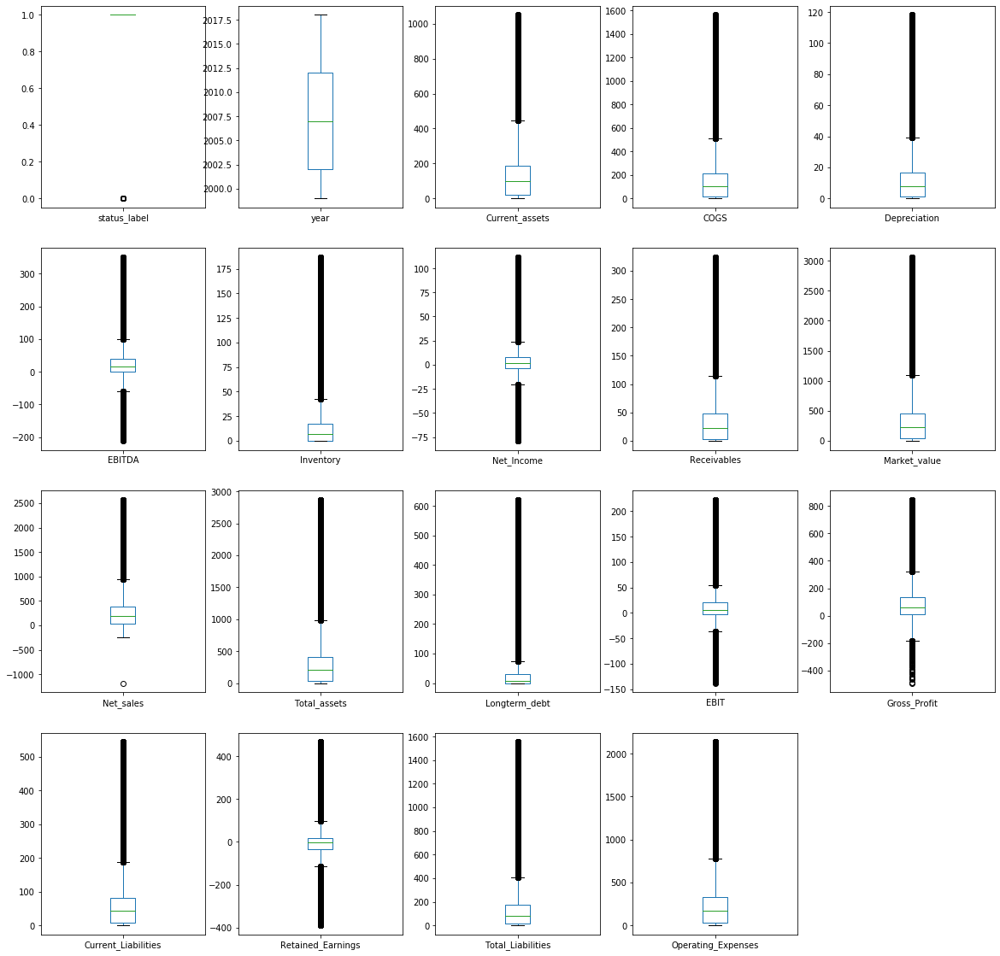

In [40]:
#checking outliers
df_clean.plot(kind = 'box', subplots = True, figsize = (20,20), layout = (4,5))

#### we can notice the enhancment in the data. Outliers still exist but it will be kept in order not to lose the data and it may explain the failure of the companies

## Adding New Features

### Adding 3 new features that represent different financial ratios in order to facilitate the comparison between companies which may help the accuracy of detecting failed companies

- Equity: the amount returned to shareholders after liquidating assets and settling debts 
- Leverage = indicates how much debts are used to generate assets (solvency ratio)
- Current_Ratio = indicator of the company's ability to meet its short term obligations (liquidity ratio)

In [41]:
#copying the clean data before adding the features to keep its original values
df2=df_clean.copy()
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78682 entries, 0 to 78681
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   status_label         78682 non-null  int64  
 1   year                 78682 non-null  int64  
 2   Current_assets       78682 non-null  float64
 3   COGS                 78682 non-null  float64
 4   Depreciation         78682 non-null  float64
 5   EBITDA               78682 non-null  float64
 6   Inventory            78682 non-null  float64
 7   Net_Income           78682 non-null  float64
 8   Receivables          78682 non-null  float64
 9   Market_value         78682 non-null  float64
 10  Net_sales            78682 non-null  float64
 11  Total_assets         78682 non-null  float64
 12  Longterm_debt        78682 non-null  float64
 13  EBIT                 78682 non-null  float64
 14  Gross_Profit         78682 non-null  float64
 15  Current_Liabilities  78682 non-null 

In [42]:
#Calculating the values of new features using the existing features
df2['Equity'] = df2['Total_assets'] - df2['Total_Liabilities']
df2['Leverage'] = df2['Total_Liabilities']/df2['Equity']
df2['Current_Ratio'] = df2['Current_assets']/df2['Current_Liabilities']

In [43]:
# Rounding figures to 2 decimales
df2.round({'Current_Ratio':2, 'Equity':2, 'Leverage':2})

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,...,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Liabilities,Operating_Expenses,Equity,Leverage,Current_Ratio
0,1,1999,511.267,833.107,18.373,89.031,7.023,35.163,128.348,372.7519,...,180.4470,70.658,191.226,163.816,201.026,401.483,935.302,339.52,1.18,3.12
1,1,2000,485.856,713.811,18.577,64.367,7.023,18.531,115.187,377.1180,...,179.9870,45.790,160.444,125.392,204.065,361.642,809.888,340.21,1.06,3.87
2,1,2001,436.656,526.477,22.496,27.207,7.023,-58.939,77.528,364.5928,...,217.6990,4.711,112.244,150.464,139.603,399.964,611.514,310.23,1.29,2.90
3,1,2002,396.412,496.747,27.172,30.745,7.023,-12.410,66.322,143.3295,...,164.6580,3.573,109.590,203.575,124.106,391.633,575.592,294.99,1.33,1.95
4,1,2003,432.204,523.302,26.680,47.491,7.023,3.504,104.661,308.9071,...,248.6660,20.811,128.656,131.261,131.884,407.608,604.467,301.68,1.35,3.29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78677,1,2014,233.211,43.338,14.094,45.615,3.376,25.261,22.846,756.4827,...,184.6660,31.521,60.885,28.197,28.095,225.887,58.608,873.21,0.26,8.27
78678,1,2015,105.559,59.184,42.592,202.133,2.288,1.616,54.611,527.5750,...,7.5935,159.541,231.969,88.128,157.783,880.327,89.020,985.60,0.89,1.20
78679,1,2016,63.971,69.074,65.057,79.051,2.581,-1.442,42.467,578.8868,...,7.5935,13.994,100.784,85.765,156.341,770.233,90.807,976.00,0.79,0.75
78680,1,2017,135.207,66.527,65.330,69.171,2.013,-20.401,27.217,412.6241,...,7.5935,3.841,95.357,82.010,135.941,776.697,92.713,959.41,0.81,1.65


status_label              AxesSubplot(0.125,0.749828;0.110714x0.130172)
year                   AxesSubplot(0.257857,0.749828;0.110714x0.130172)
Current_assets         AxesSubplot(0.390714,0.749828;0.110714x0.130172)
COGS                   AxesSubplot(0.523571,0.749828;0.110714x0.130172)
Depreciation           AxesSubplot(0.656429,0.749828;0.110714x0.130172)
EBITDA                 AxesSubplot(0.789286,0.749828;0.110714x0.130172)
Inventory                 AxesSubplot(0.125,0.593621;0.110714x0.130172)
Net_Income             AxesSubplot(0.257857,0.593621;0.110714x0.130172)
Receivables            AxesSubplot(0.390714,0.593621;0.110714x0.130172)
Market_value           AxesSubplot(0.523571,0.593621;0.110714x0.130172)
Net_sales              AxesSubplot(0.656429,0.593621;0.110714x0.130172)
Total_assets           AxesSubplot(0.789286,0.593621;0.110714x0.130172)
Longterm_debt             AxesSubplot(0.125,0.437414;0.110714x0.130172)
EBIT                   AxesSubplot(0.257857,0.437414;0.110714x0.

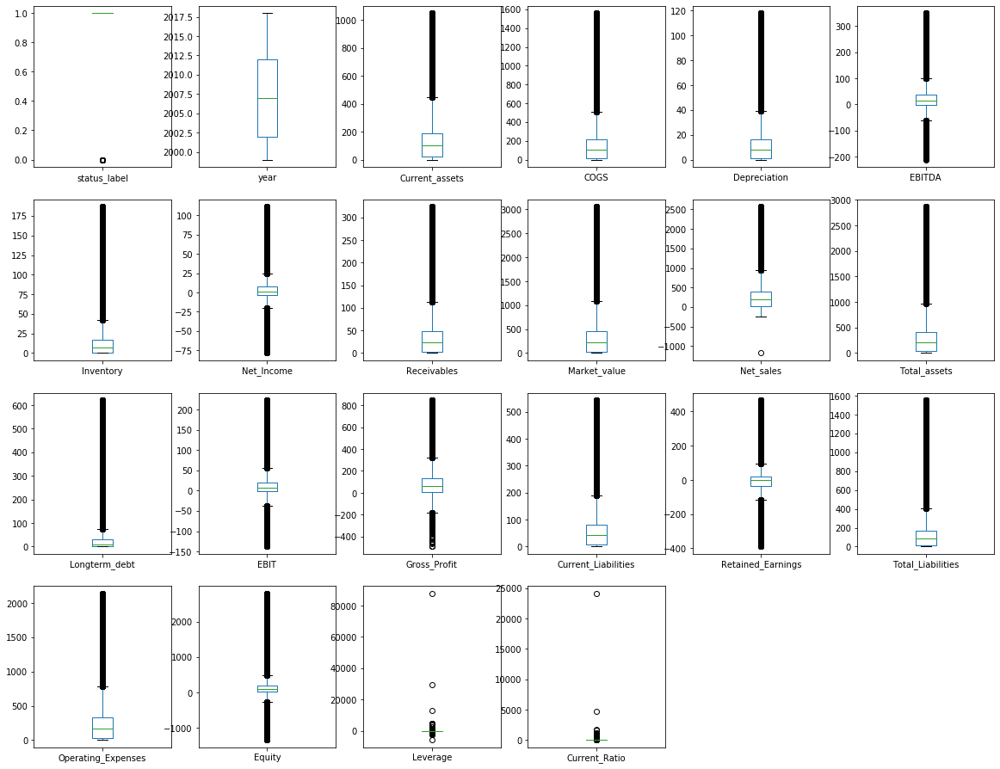

In [44]:
#checking outliers of the new features
df2.plot(kind = 'box', subplots = True, figsize = (20,20), layout = (5,6))

In [45]:
df2.describe()

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,...,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Liabilities,Operating_Expenses,Equity,Leverage,Current_Ratio
count,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,...,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,7.868200e+04,78682.000000
mean,0.933657,2007.506317,159.313537,204.638932,15.528222,35.698042,19.974127,4.875413,43.671626,417.706653,...,57.160359,18.159885,115.312259,74.929039,0.585303,182.583535,303.376837,207.272449,inf,3.929415
std,0.248882,5.742768,213.439727,313.344567,23.617644,74.139541,36.710168,27.227078,65.646967,618.122785,...,122.528369,49.521793,174.872750,107.977841,125.404449,301.142091,438.262493,415.479625,NaN,88.775044
min,0.000000,1999.000000,0.001000,0.000000,0.000000,-211.410000,0.000000,-78.746000,0.000000,0.000100,...,0.000000,-137.942000,-490.662000,0.001000,-389.700000,0.001000,0.000000,-1341.266500,-5.847000e+03,0.000045
25%,1.000000,2002.000000,18.924000,17.040000,1.192000,-0.712000,0.000000,-3.511750,3.281250,34.980000,...,0.000000,-2.237000,8.594000,8.889250,-35.585750,13.486000,32.875000,13.807750,2.464965e-01,1.299526
50%,1.000000,2007.000000,100.447750,103.668000,7.929250,15.034500,7.023000,1.616000,22.820000,227.507675,...,7.593250,6.518000,63.581500,43.331000,-1.131000,81.987500,168.921750,98.635000,6.248347e-01,2.318083
75%,1.000000,2012.000000,189.254000,215.118250,16.430250,39.137750,16.892500,7.555500,47.530750,458.971800,...,29.285500,20.613750,134.704000,80.563750,17.725000,171.271500,331.710750,199.654500,1.154212e+00,3.301845
max,1.000000,2018.000000,1050.380000,1560.600000,118.120000,350.324000,186.863000,111.477000,323.935000,3059.561700,...,621.809000,223.115000,847.257000,543.700000,467.485000,1554.601000,2139.179000,2790.012000,inf,24108.000000


- There are outliers in the new features however it will be kept as those features are already calculated based on the clean data and outliers may explain companies failures
- Some features have inf and -inf value which may affect the model 

In [46]:
#copying data to keep the values after adding the new features
df3=df2.copy()

In [47]:
# removing inf & -inf value 
df3.replace([np.inf, -np.inf], np.nan, inplace=True) 
df3.dropna(inplace=True)

In [48]:
# checking the removal of inf & -inf 
df3.describe()

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,...,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Liabilities,Operating_Expenses,Equity,Leverage,Current_Ratio
count,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000,78681.00000,78681.000000,...,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000,78681.000000
mean,0.933656,2007.506323,159.315527,204.641528,15.528419,35.698533,19.974379,4.875533,43.67218,417.711416,...,57.161070,18.160154,115.313728,74.929969,0.585487,182.585812,303.380654,207.275083,2.651423,3.929445
std,0.248884,5.742805,213.440354,313.345712,23.617730,74.139884,36.710333,27.227230,65.64720,618.125269,...,122.528985,49.522050,174.873376,107.978212,125.405235,301.143327,438.263971,415.481609,337.226658,88.775608
min,0.000000,1999.000000,0.001000,0.000000,0.000000,-211.410000,0.000000,-78.746000,0.00000,0.000100,...,0.000000,-137.942000,-490.662000,0.001000,-389.700000,0.001000,0.000000,-1341.266500,-5847.000000,0.000045
25%,1.000000,2002.000000,18.924000,17.040000,1.192000,-0.712000,0.000000,-3.511000,3.28200,34.980000,...,0.000000,-2.237000,8.594000,8.890000,-35.586000,13.486000,32.878000,13.810000,0.246493,1.299523
50%,1.000000,2007.000000,100.449500,103.674000,7.929500,15.034500,7.023000,1.616000,22.82000,227.511850,...,7.593500,6.518000,63.581500,43.333000,-1.131000,81.988000,168.924500,98.636000,0.624835,2.318083
75%,1.000000,2012.000000,189.264000,215.122000,16.431000,39.138000,16.893000,7.556000,47.53100,459.000800,...,29.286000,20.614000,134.706000,80.564000,17.725000,171.285000,331.713000,199.657000,1.154194,3.301856
max,1.000000,2018.000000,1050.380000,1560.600000,118.120000,350.324000,186.863000,111.477000,323.93500,3059.561700,...,621.809000,223.115000,847.257000,543.700000,467.485000,1554.601000,2139.179000,2790.012000,87701.500000,24108.000000


#### only one row is lost which is immaterial

### Univariate Analysis

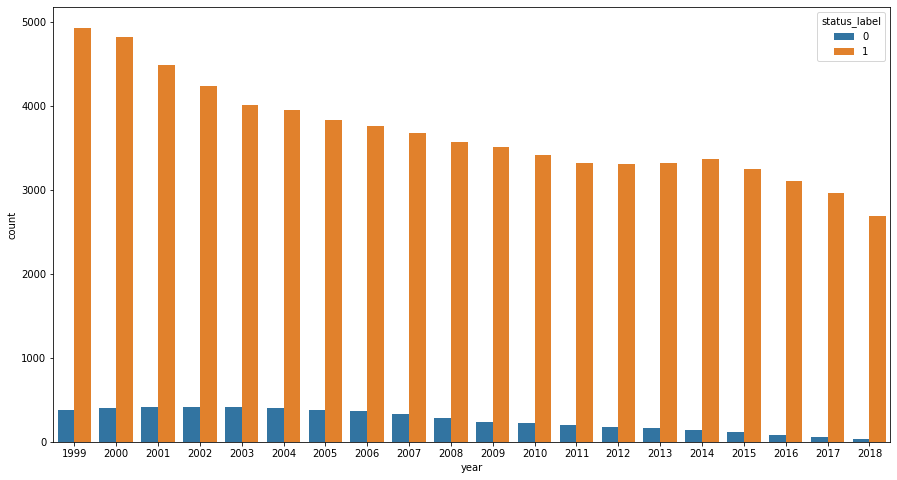

In [49]:
plt.figure(figsize=(15,8))
sns.countplot(data = df3, x='year', hue='status_label')

- The failure is higher in the earlier year then it takes a decreasing trend 

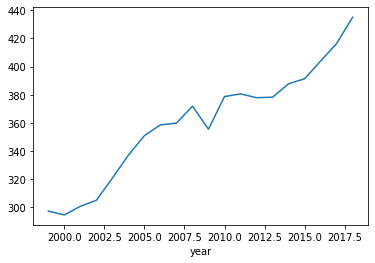

In [50]:
df3.groupby(['year'])['Net_sales'].mean().plot()

- upward trend of sales till 2008
- the lowest companies sales figures occured in 2009
- rebound of companies sales starting from 2010

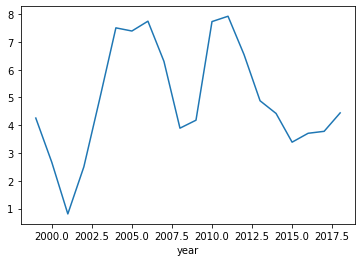

In [51]:
df3.groupby(['year'])['Net_Income'].mean().plot()

- fluctuations in companies net income through years under study
- upward trend is noticed starting from 2015 but with lower pace 

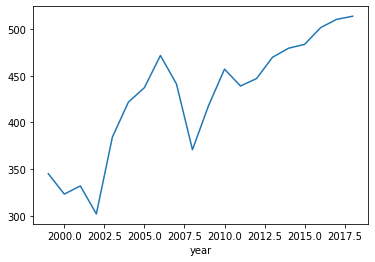

In [52]:
df3.groupby(['year'])['Market_value'].mean().plot()

- lowest market value of companies was in 2002 followed by 2008
- upward trend noticed in last couple of years 

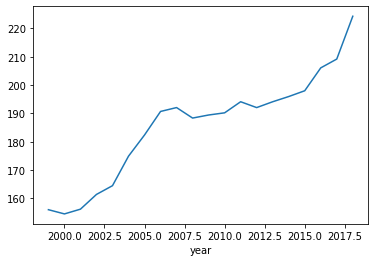

In [53]:
df3.groupby(['year'])['Total_Liabilities'].mean().plot()

- upward trend of total liabilities is noticed through years under study

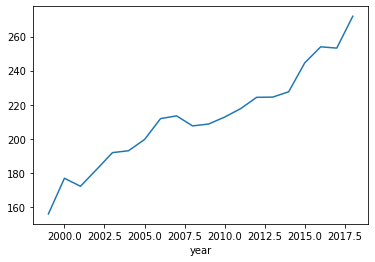

In [64]:
df3.groupby(['year'])['Equity'].mean().plot()

- Increasing trend of equity through years under study 

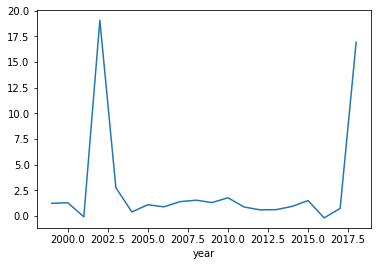

In [65]:
df3.groupby(['year'])['Leverage'].mean().plot()

- low reliance on debts in the majority of years on average except for 2002 and 2018 where the average leverage is very high 

### Bivariate Analysis

In [57]:
px.scatter(df3, x='Total_assets', y='Total_Liabilities', color='status_label')

- there is linear relatiobship between assets and liabilities but not very clear
- failed companies tend to have lower assets value

In [63]:
px.scatter(df3, x='Total_assets', y='Equity', color='status_label')

- clear linear relationship between assests and equity
- we can notice that failed companies tend to have lower equity and assets

In [58]:
px.scatter(df3, x='Net_Income', y='COGS', color='status_label')

- no clear relationship between both variables
- failed companies tend to have negative net income 

In [59]:
px.scatter(df3, x='Net_sales', y='COGS', color='status_label')

- linear relationship between cogs and sales is noticed 

In [60]:
px.scatter(df3, x='Operating_Expenses', y='COGS', color='status_label')

- Linear relationship between cogs & operating expenses is noticed

In [61]:
# checking the correlation between features
df3.corr()

,status_label,year,Current_assets,COGS,Depreciation,EBITDA,Inventory,Net_Income,Receivables,Market_value,...,Longterm_debt,EBIT,Gross_Profit,Current_Liabilities,Retained_Earnings,Total_Liabilities,Operating_Expenses,Equity,Leverage,Current_Ratio
status_label,1.000000,0.083339,0.024439,-0.004473,0.000783,0.009007,-0.015661,0.052103,0.008822,0.040153,...,-0.025015,0.028899,0.011092,0.003663,0.042017,-0.017055,0.002329,0.011867,0.000406,0.003002
year,0.083339,1.000000,0.089210,0.072713,0.069242,0.039846,0.006489,0.014357,0.061875,0.090943,...,0.014299,0.025496,0.074964,0.082615,-0.040367,0.058818,0.079369,0.066395,-0.000371,0.000593
Current_assets,0.024439,0.089210,1.000000,0.516572,0.475076,0.488958,0.354542,0.314605,0.592640,0.500309,...,0.343027,0.423350,0.593141,0.635629,0.267213,0.501882,0.592856,0.488234,-0.002239,0.009295
COGS,-0.004473,0.072713,0.516572,1.000000,0.464533,0.455539,0.357604,0.288731,0.543042,0.344475,...,0.326884,0.397735,0.475008,0.552946,0.264304,0.459185,0.797124,0.333962,-0.000229,-0.006214
Depreciation,0.000783,0.069242,0.475076,0.464533,1.000000,0.549513,0.235265,0.262424,0.442032,0.406660,...,0.439366,0.402670,0.491696,0.517742,0.212427,0.573880,0.504779,0.459637,0.010704,-0.006477
EBITDA,0.009007,0.039846,0.488958,0.455539,0.549513,1.000000,0.273054,0.502646,0.476017,0.493147,...,0.381953,0.760458,0.607312,0.498729,0.350677,0.520537,0.481936,0.458398,0.003977,-0.004821
Inventory,-0.015661,0.006489,0.354542,0.357604,0.235265,0.273054,1.000000,0.218728,0.347434,0.215527,...,0.197407,0.262776,0.326778,0.295165,0.256371,0.242123,0.365166,0.188157,-0.001748,-0.003474
Net_Income,0.052103,0.014357,0.314605,0.288731,0.262424,0.502646,0.218728,1.000000,0.304280,0.376545,...,0.193488,0.613197,0.373288,0.284270,0.423558,0.264151,0.292703,0.254828,-0.003228,-0.001731
Receivables,0.008822,0.061875,0.592640,0.543042,0.442032,0.476017,0.347434,0.304280,1.000000,0.390360,...,0.346801,0.423382,0.527970,0.587448,0.275726,0.480124,0.585541,0.391141,-0.000519,-0.005000
Market_value,0.040153,0.090943,0.500309,0.344475,0.406660,0.493147,0.215527,0.376545,0.390360,1.000000,...,0.277637,0.446622,0.511385,0.432390,0.238081,0.381269,0.391832,0.405003,-0.002923,-0.000607


In [62]:
px.imshow(df3.corr())

- no strong correlation between the variables and the target.
- we can notice a week negative correlation between the target and (COGS, Inventory, long term debts, Total Liabilities )
- Strong correlation between the following features:
   - equity and total assets 0.86 and total assets vs total liabilities is 0.72 which mean that the reliance on equity to finance assets is higher
   - Operating expenses and sales 0.88
   - COGS & Sales 0.75
   - COGS & operating expenses 0.79
- Medium correlation between the following features:
    - current assets and total assets 0.61
    - current assets and receivables 0.59 noting that the correlation between current assets vs inventory is 0.35 which means that the recivables represents a bigger portion of current assets vs inventory
    - current assets and sales 0.61 matching the correlation between current assets and receivables
    - net sales and gross profit 0.62 noting that the correlation between cogs and gross profit is 0.42 which means the impact of sales on the gross profit is higher reflecting some control over direct costs 

# Modelling- Classification Model

In [68]:
#for data splitting
from sklearn.model_selection import train_test_split

# selected models to be tested 
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier,plot_tree
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
import xgboost as xgb

# to handle imbalanced target feature
from imblearn.over_sampling import RandomOverSampler


#for features selection
from sklearn.feature_selection import (
    f_classif,
    SelectFpr,
    SelectKBest,
)

# to test the model accuracy
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score 


#for hyperparameters tunning
from sklearn.model_selection import GridSearchCV

# for cross-validation of the model
from sklearn.model_selection import cross_val_score, KFold

In [69]:
#copying data before starting the modeling
df4=df3.copy()

In [70]:
#Splitting Data 
x = df4.drop('status_label', axis = 1)
y = df4['status_label']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, stratify=y, random_state=42)

In [71]:
# Over sampling data to handle imbalanced data
oversampler = RandomOverSampler()
x_train, y_train = oversampler.fit_resample(x_train, y_train)

In [72]:
# Checking thebresult of the oversampling
y_train.value_counts()    

1    58768
0    58768
Name: status_label, dtype: int64

- Data is now balanced 

## Features Selection

In [73]:
# features selection using the ANOVA method as the variables are numerical and the target is categrical

univariate = f_classif(x_train, y_train)
print(univariate)

(array([3.99715202e+03, 3.17130318e+02, 7.57869678e+00, 3.19523145e-02,
       5.56328253e+01, 1.23043312e+02, 1.54689299e+03, 3.88261495e+01,
       9.67572163e+02, 5.81787066e-01, 5.62704598e+00, 2.92403817e+02,
       3.89847551e+02, 1.10249634e+02, 2.71701846e+01, 9.16126039e+02,
       1.08536725e+02, 6.16833463e+00, 1.16478352e+02, 1.06729295e-01,
       7.20078148e+00]), array([0.00000000e+000, 7.57374599e-071, 5.90711881e-003, 8.58132663e-001,
       8.79501930e-014, 1.40973257e-028, 0.00000000e+000, 4.64843416e-010,
       1.46187676e-211, 4.45614230e-001, 1.76870110e-002, 1.78724205e-065,
       1.23557376e-086, 8.86988874e-026, 1.86623827e-007, 1.81647867e-200,
       2.10311616e-025, 1.30070812e-002, 3.84549162e-027, 7.43899544e-001,
       7.28820423e-003]))


Text(0.5, 1.0, 'Anova')

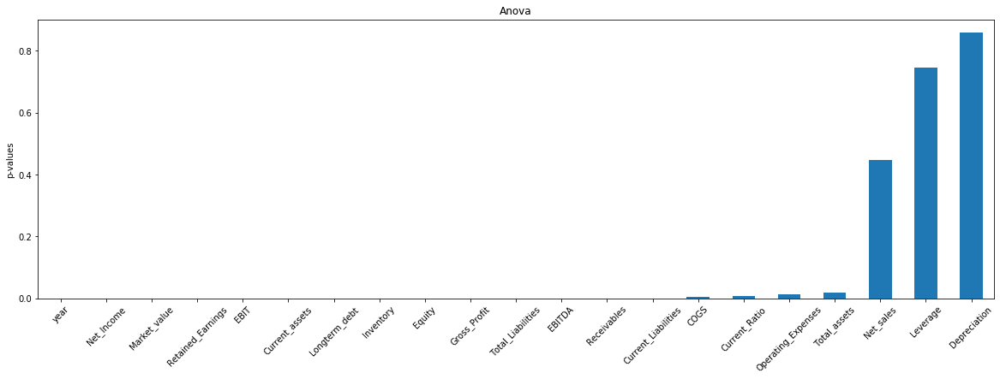

In [74]:
univariate = pd.Series(univariate[1])   #getting the p-value of variables
univariate.index = x_train.columns      #getting the name of variables in an index
univariate.sort_values(ascending=True).plot.bar(figsize=(20, 6), rot=45) #sorting the variables based on the p-value and plotting the values
plt.ylabel("p-values")
plt.title("Anova")

In [75]:
#selecting features with alpha = 0.05
sel = SelectFpr(f_classif, alpha =0.05).fit(x_train, y_train)

In [76]:
# getting the name of selected features
x_train.columns[sel.get_support()]

Index(['year', 'Current_assets', 'COGS', 'EBITDA', 'Inventory', 'Net_Income',
       'Receivables', 'Market_value', 'Total_assets', 'Longterm_debt', 'EBIT',
       'Gross_Profit', 'Current_Liabilities', 'Retained_Earnings',
       'Total_Liabilities', 'Operating_Expenses', 'Equity', 'Current_Ratio'],
      dtype='object')

- The selected features include 2 out of the 3 added features (the equity and the current ratio)
- The selected features include that we conclude it has impact on the target featutre such as the net income, the total assets, the total liabilities, the year.

In [77]:
# Reducing the data to the selected feautures
x_train_t = sel.transform(x_train)
x_test_t = sel.transform(x_test)
x_train_t = pd.DataFrame(x_train_t, columns=sel.get_feature_names_out())
x_test_t = pd.DataFrame(x_test_t, columns=sel.get_feature_names_out())

## Testing the models

### Scenario(1) : Testing models using the selected features 

In [78]:
models = {
    'lr': LogisticRegression(),
    'KNN': KNeighborsClassifier(),
    'DT': DecisionTreeClassifier(),
    'RF': RandomForestClassifier(),
    'gb': GradientBoostingClassifier(),
    'xgbc': xgb.XGBClassifier()
    
}

for name, model in models.items():
    model.fit(x_train_t, y_train)
    train_acc = model.score(x_train_t, y_train)
    test_acc = model.score(x_test_t, y_test)
    print(f'Model {name}:\nTraining Accuracy: {train_acc} - Testing Accuracy: {test_acc}')
    y_pred = model.predict(x_train_t)
    y_pred1 = model.predict(x_test_t)
    print('Confusion_matrix:')
    print(confusion_matrix(y_test, y_pred1))
    print('classification_report:')
    print('Train:')
    print(classification_report(y_train, y_pred))
    print('Test:')
    print(classification_report(y_test,y_pred1))

C:\Anaconda\lib\site-packages\sklearn\linear_model\_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Model lr:
Training Accuracy: 0.5989398992649061 - Testing Accuracy: 0.6060875643388194
Confusion_matrix:
[[ 591  453]
 [5746 8947]]
classification_report:
Train:
              precision    recall  f1-score   support

           0       0.60      0.59      0.60     58768
           1       0.60      0.61      0.60     58768

    accuracy                           0.60    117536
   macro avg       0.60      0.60      0.60    117536
weighted avg       0.60      0.60      0.60    117536

Test:
              precision    recall  f1-score   support

           0       0.09      0.57      0.16      1044
           1       0.95      0.61      0.74     14693

    accuracy                           0.61     15737
   macro avg       0.52      0.59      0.45     15737
weighted avg       0.89      0.61      0.70     15737

Model KNN:
Training Accuracy: 0.9509682139940103 - Testing Accuracy: 0.8560081336976552
Confusion_matrix:
[[  567   477]
 [ 1789 12904]]
classification_report:
Train:
           

- The lr and gb have the lowest test accuracy rate. lr: 0.60 and gb 0.69. Hence, both model will be excluded
Comparing the remaining 4 models, the accuracy rate are ranked as follow
- The highest accuracy rate is RF: 0.93 followed 
- DT: 0.89
- KNN: 0.85
- xgbc:0.83

The 4 models have high recall and precision rates at the level of the training data

At the level of the test data

- The 4 models have lower recall and precision rate at the level of class "0"
- The 4 models have high recall and precision rate at the level of class "1"
- The KNN has the highest average recall and precision rate (f1-score) for class "0" followed by the xgbc, DT then RF. It is also confirmed by looking to the confusion matrix 
- The KNN and xgbc have highest recall at the level of class "0"
- The RF has the highest average recall and precision rate for class "1" followed by the DT, KNN then xgbc 


## Hyperparameters Tunning

Applying hyperparameters tunning on models with test accuracy > 80% in order to optimize the learning of the models, controling the overfitting and underfitting and improve the accuracy of the model

Hyperparameters tunning is done through grid search method

In [153]:
KNN = KNeighborsClassifier()
params = {
    'n_neighbors': [3, 7]
}

grid = GridSearchCV(KNN, params)
grid.fit(x_train_t, y_train)
grid.best_params_

{'n_neighbors': 3}

In [152]:
DT = DecisionTreeClassifier()

params = {
'max_depth': [50, 60, 70],
'min_samples_leaf': [5,10,20],

}

grid2 = GridSearchCV(DT, params)
grid2.fit(x_train_t, y_train)
grid2.best_params_

{'max_depth': 50, 'min_samples_leaf': 5}

In [150]:
RF = RandomForestClassifier()
params = {
'n_estimators': [50, 70, 95],
'min_samples_leaf': [5, 10, 20],
'max_depth': [15,20,30]
}

grid3 = GridSearchCV(RF, params)
grid3.fit(x_train_t, y_train)
grid3.best_params_

{'max_depth': 30, 'min_samples_leaf': 5, 'n_estimators': 95}

In [75]:
xgbc1 = xgb.XGBClassifier()
params = {
'max_depth': [10,11,15],
'learning_rate': [0.1, 0.01, 0.001]
}

grid4 = GridSearchCV(xgbc1, params)
grid4.fit(x_train_t, y_train)
grid4.best_params_

{'learning_rate': 0.1, 'max_depth': 15}

### Scenario(2) : Testing models after hyperparameter tunning
to check the precision and recall and the confusion matrix

In [79]:
models = {
    'knn1': KNeighborsClassifier(n_neighbors = 3),
    'dt1': DecisionTreeClassifier(max_depth=50, min_samples_leaf=5,random_state =42),
    'rf1': RandomForestClassifier(n_estimators=95,
                                min_samples_leaf = 5,
                                max_depth = 30, 
                            random_state =42),
    'xgbc1': xgb.XGBClassifier(max_depth=15, learning_rate= 0.1, random_state =42),
    
}

for name, model in models.items():
    model.fit(x_train_t, y_train)
    train_acc = model.score(x_train_t, y_train)
    test_acc = model.score(x_test_t, y_test)
    print(f'Model {name}:\nTraining Accuracy: {train_acc} - Testing Accuracy: {test_acc}')
    y_pred = model.predict(x_train_t)
    y_pred1 = model.predict(x_test_t)
    print('Confusion_matrix:')
    print(confusion_matrix(y_test, y_pred1))
    print('classification_report:')
    print('Train:')
    print(classification_report(y_train, y_pred))
    print('Test:')
    print(classification_report(y_test,y_pred1))

Model knn1:
Training Accuracy: 0.969932616389872 - Testing Accuracy: 0.8934358518141958
Confusion_matrix:
[[  499   545]
 [ 1132 13561]]
classification_report:
Train:
              precision    recall  f1-score   support

           0       0.96      0.98      0.97     58768
           1       0.98      0.96      0.97     58768

    accuracy                           0.97    117536
   macro avg       0.97      0.97      0.97    117536
weighted avg       0.97      0.97      0.97    117536

Test:
              precision    recall  f1-score   support

           0       0.31      0.48      0.37      1044
           1       0.96      0.92      0.94     14693

    accuracy                           0.89     15737
   macro avg       0.63      0.70      0.66     15737
weighted avg       0.92      0.89      0.90     15737

Model dt1:
Training Accuracy: 0.9741611080860332 - Testing Accuracy: 0.8717671729046197
Confusion_matrix:
[[  285   759]
 [ 1259 13434]]
classification_report:
Train:
      

After Hyperparameters tunning vs. before  Hyperparameters tunning 
The test accuracy of all models enhanced except for the dt: 
- RF:0.938 vs. 0.934 
- DT:0.87 vs. 0.89
- KNN: 0.89 vs. 0.85
- xgbc:0.934 vs. 0.83

knn1 and dt1 will be excluded as they have lower accuracy rate than rf1 and xgbc1

RF vs xgbc:

- both models almost have same training and test accuracy 
- the accuracy of rf1 is slightly higher than xgbc1

- xgbc1 has higher recall rate at the level of class "0"
- rf1 has higher precision rate at the level of class "0"
- xgb1c has higher average recall and precision (f1-score) rate for class "0"

- rf1 has higher recall rate at the level of class "1"
- xgbc has higher precision rate at the level of class "1"
- Both have same average recall and precision (f1-score) rate for class "1"
- Above conclusion is also confirmed by the confusion matrix

Despite the fact that rf1 is slightly higher than xgbc at the level of the overall test accuracy. But, the xgbc1 is giving more accurate results as it is more accurate at the level of predicting class "0" that reflects the failed companies in addition both have same average recall and precision (f1-score) rate for class "1". 

### Scenario (3) Selecting the top 10 features based on the Anova method

In [80]:
# selecting the top 10 features
sel2 = SelectKBest(f_classif, k=10).fit(x_train, y_train)

In [81]:
# getting the name of the top 10 features
x_train.columns[sel2.get_support()]

Index(['year', 'Current_assets', 'Inventory', 'Net_Income', 'Market_value',
       'Longterm_debt', 'EBIT', 'Gross_Profit', 'Retained_Earnings', 'Equity'],
      dtype='object')

The top 10 features include the equity (one of the newly added features)

In [82]:
#splitting the data using the top 10 features

x2 = df4[['year', 'Current_assets', 'Net_Income', 'Market_value', 'Longterm_debt',
       'EBIT', 'Gross_Profit', 'Retained_Earnings', 'Total_Liabilities',
       'Equity']]
y2 = df4['status_label']

x2_train, x2_test, y2_train, y2_test = train_test_split(x2, y2, test_size = 0.2, stratify=y2, random_state=42)


# Over-sampling the data 

x2_train, y2_train = oversampler.fit_resample(x2_train, y2_train)

y2_train.value_counts()

1    58768
0    58768
Name: status_label, dtype: int64

In [83]:
#testing the 2 most accurate models based on Scenario (2)

models = {

    'rf3': RandomForestClassifier(n_estimators=95,
                                min_samples_leaf = 5,
                                max_depth = 30, 
                            random_state =42),
    'xgbc3': xgb.XGBClassifier(max_depth=15, learning_rate= 0.1, random_state =42)
    
}

for name, model in models.items():
    model.fit(x2_train, y2_train)
    train_acc = model.score(x2_train, y2_train)
    test_acc = model.score(x2_test, y2_test)
    print(f'Model {name}:\nTraining Accuracy: {train_acc} - Testing Accuracy: {test_acc}')
    y2_pred = model.predict(x2_train)
    y2_pred1 = model.predict(x2_test)
    print('Confusion_matrix:')
    print(confusion_matrix(y2_test, y2_pred1))
    print('classification_report:')
    print('Train:')
    print(classification_report(y2_train, y2_pred))
    print('Test:')
    print(classification_report(y2_test,y2_pred1))

Model rf3:
Training Accuracy: 0.9848386877212089 - Testing Accuracy: 0.9335324394738514
Confusion_matrix:
[[  185   859]
 [  187 14506]]
classification_report:
Train:
              precision    recall  f1-score   support

           0       1.00      0.97      0.98     58768
           1       0.97      1.00      0.99     58768

    accuracy                           0.98    117536
   macro avg       0.99      0.98      0.98    117536
weighted avg       0.99      0.98      0.98    117536

Test:
              precision    recall  f1-score   support

           0       0.50      0.18      0.26      1044
           1       0.94      0.99      0.97     14693

    accuracy                           0.93     15737
   macro avg       0.72      0.58      0.61     15737
weighted avg       0.91      0.93      0.92     15737

Model xgbc3:
Training Accuracy: 0.9823032943098284 - Testing Accuracy: 0.9203787252970705
Confusion_matrix:
[[  256   788]
 [  465 14228]]
classification_report:
Train:
    

- The test accuracy of both models is less than the one obtained in scenario (2)
   - RF:0.933 vs 0.938
   - xgbc:0.92 vs 0.934 

- Then, xgbc1 obtained in scenario (2) is the most accurate with higher recall rate for class (0)


## Cross Validation 
To confirm on the accuracy of the xgbc1 model 

In [84]:
# Defining the number of folds for cross-validation
num_folds = 10
kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)

In [85]:
# performing k-fold cross-validation on the training data
xgbc1 = xgb.XGBClassifier(max_depth=15, learning_rate= 0.1, random_state =42)
cross_val_results = cross_val_score(xgbc1, x_train_t, y_train, cv=kf)

# printing the evaluation metrics
print(f'Cross-Validation Results (Accuracy): {cross_val_results}')
print(f'Mean Accuracy: {cross_val_results.mean()}')

Cross-Validation Results (Accuracy): [0.97830526 0.97745448 0.97864557 0.97873064 0.97787987 0.97694402
 0.97983494 0.98077087 0.97974985 0.97745257]
Mean Accuracy: 0.9785768062635629


In [86]:
# performing k-fold cross-validation on test data
xgbc1 = xgb.XGBClassifier(max_depth=15, learning_rate= 0.1, random_state =42)
cross_val_results = cross_val_score(xgbc1, x_test_t, y_test, cv=kf)

# printing the evaluation metrics
print(f'Cross-Validation Results (Accuracy): {cross_val_results}')
print(f'Mean Accuracy: {cross_val_results.mean()}')

Cross-Validation Results (Accuracy): [0.9364676  0.92693774 0.93329098 0.93265565 0.93456163 0.93964422
 0.93773825 0.9408773  0.93134139 0.93642721]
Mean Accuracy: 0.9349941960546095


#### The model shows consistent accuracy in the 10 folds of the cross validation

### The Selected Model is xgbc1 

In [92]:
xgbc1 = xgb.XGBClassifier(max_depth=15, learning_rate= 0.1, random_state =42)
xgbc1.fit(x_train_t, y_train)
y_pred1 = xgbc1.predict(x_test_t)

In [98]:
row_to_predict = [[2010,   76.1740,   164.776,   -13.4580,   22.798,   -30.027,   31.687,   267.99310, 89.269,   0,   -11.635, 19.7760,   41.561,   -25.627,   41.561,   154.4740,  6.2880,   0.829431]] 
d_test = pd.DataFrame(row_to_predict , columns = xgbc1.feature_names_in_)
xgbc1.predict(d_test)[0]

0

In [100]:
row_to_predict = [[1999,   511.267,   833.107,   89.031,   7.023,   35.163,   128.348,   372.7519,740.998 ,   180.447,   70.658, 191.226,  163.816,   201.026,   401.483,   935.302,  339.515,   3.120983]] 
d_test = pd.DataFrame(row_to_predict , columns = xgbc1.feature_names_in_)
xgbc1.predict(d_test)[0]

1

### Both rows are predicted correctly same as the original data

## Deployment Through Streamlit

### Export model to pickle

In [68]:
import joblib

In [69]:
joblib.dump(xgbc1, 'model.pkl')

['model.pkl']

#### Web Application Link

https://bankruptcy-prediction-b7uypmubvaypdurgzyffhq.streamlit.app/

## Thank You!